In [1]:
import numpy as np
import pickle
from tqdm import tqdm, tqdm_notebook
import random
import time
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import PIL
from PIL import Image
from sklearn.neighbors import NearestNeighbors
import glob
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline

In [2]:
filenames = pickle.load(open('.\\filenames.pickle', 'rb'))
features_vgg19 = pickle.load(open('.\\features_vgg19.pickle', 'rb'))
class_ids = pickle.load(open('.\\classname.pickle', 'rb'))

In [3]:
num_images = len(filenames)
num_features_per_image = len(features_vgg19[0])
print('Number of images : ', num_images)
print('Number of features per image : ', num_features_per_image)

Number of images :  5481
Number of features per image :  512


In [4]:
# defining k-nearest neighbors to search images

neigbors_vgg19 = NearestNeighbors(
    n_neighbors=5,
    algorithm='brute',
    metric='euclidean'
).fit(features_vgg19)

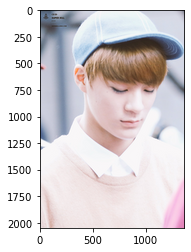

In [9]:
# testing on an image

random_index = 45
distances, indices = neigbors_vgg19.kneighbors([features_vgg19[random_index]])
plt.imshow(mpimg.imread(filenames[random_index]), interpolation='lanczos')

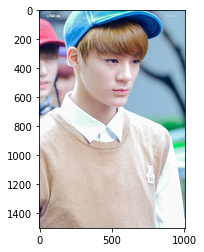

In [10]:
# first similar image

plt.imshow(mpimg.imread(filenames[indices[0][1]]), interpolation='lanczos')

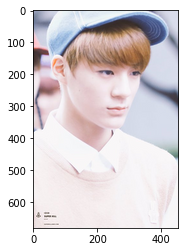

In [11]:
# second similar image

plt.imshow(mpimg.imread(filenames[indices[0][2]]), interpolation='lanczos')

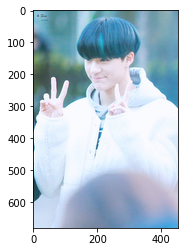

In [12]:
# third similar image

plt.imshow(mpimg.imread(filenames[indices[0][3]]), interpolation='lanczos')

In [15]:
# function to get classname
def classname(str):
    return str.split('/')[-2]

# function to get classname and filename
def classname_filename(str):
    return str.split('/')[-2] + '/' + str.split('/')[-1]

# function to plot nearest image in a given query
def plot_img(filenames, distances):
    images = []
    for filename in filenames:
        images.append(mpimg.imread(filename))
    
    plt.figure(figsize=(20,10))
    columns = 4

    for i, image in enumerate(images):
        ax = plt.subplot(int(len(images)/columns+1), int(columns), i+1)
        if i == 0:
            ax.set_title("Query Image\n" + classname_filename(filenames[i]))
        else:
            ax.set_title("Similar Image\n" + classname_filename(filenames[i]) +
                        "\nDistance: " + str(float("{0:.2f}".format(distances[i]))))
        
        plt.imshow(image)

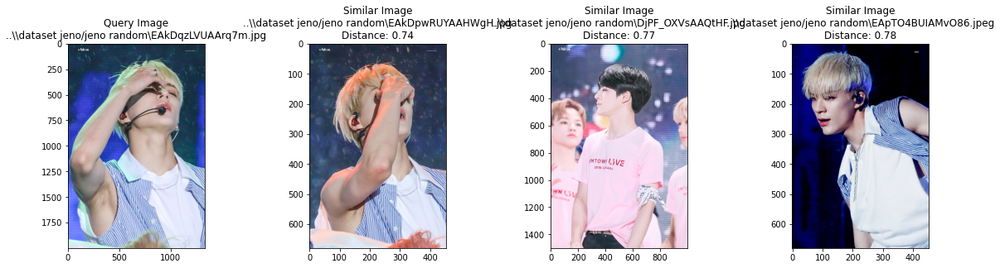

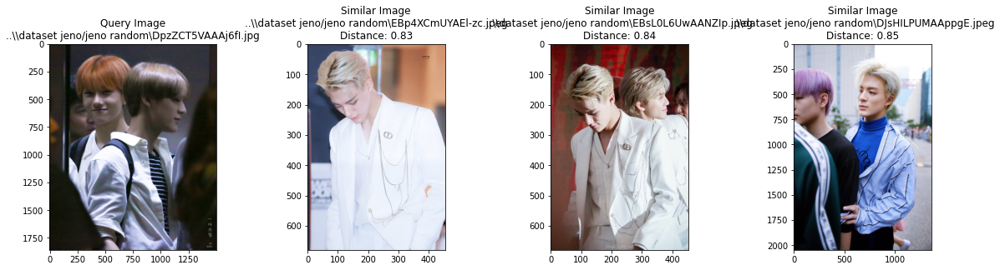

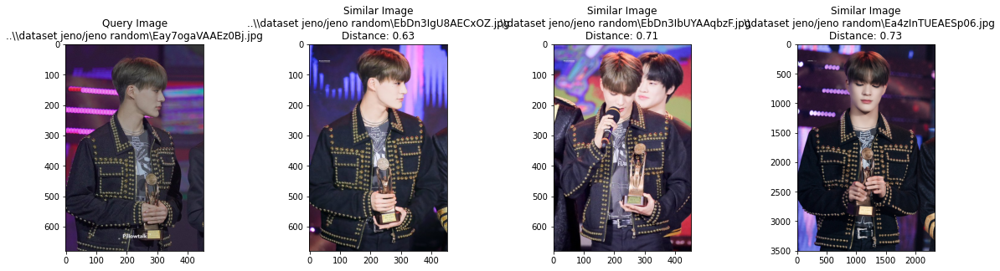

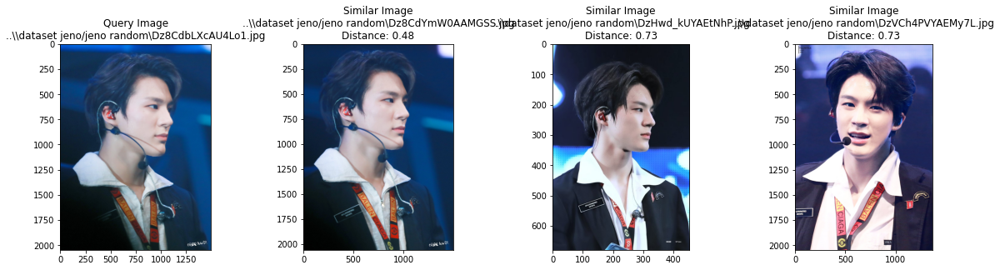

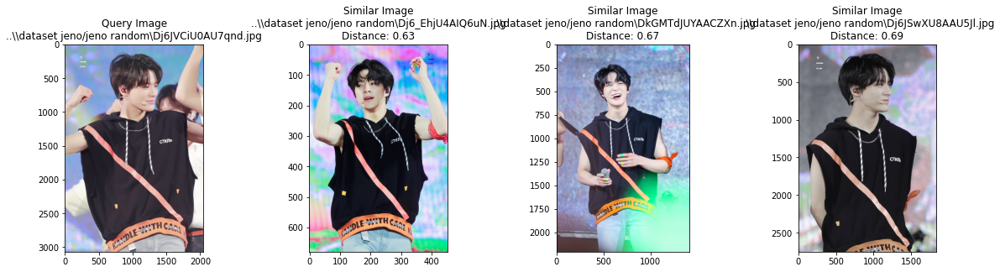

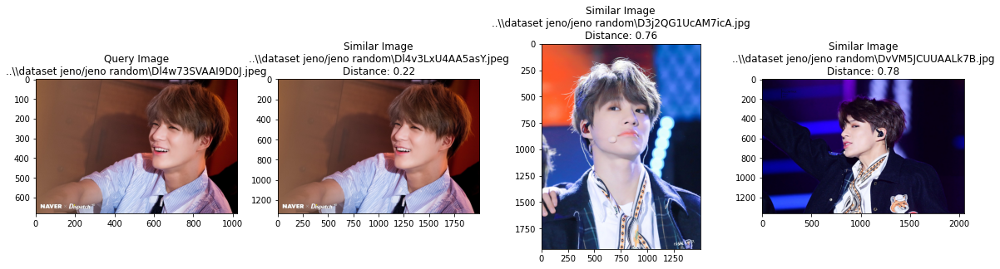

In [16]:
for i in range(6):
    random_image_index = random.randint(0, len(features_vgg19))
    distances, indices = neigbors_vgg19.kneighbors(
        [features_vgg19[random_image_index]]
    )

    # skip the 1st closest image cause it's very similar to query image
    similar_image_paths = [filenames[random_image_index]] + \
        [filenames[indices[0][i]] for i in range(1, 4)]
    plot_img(similar_image_paths, distances[0])

C:\Users\zakis\AppData\Local\Temp\ipykernel_10624\392730513.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(20,10))


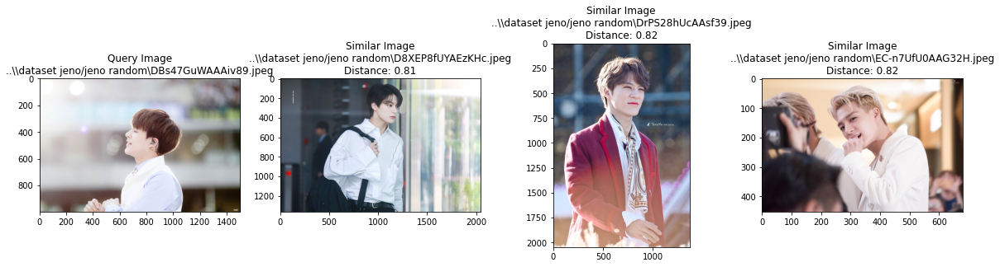

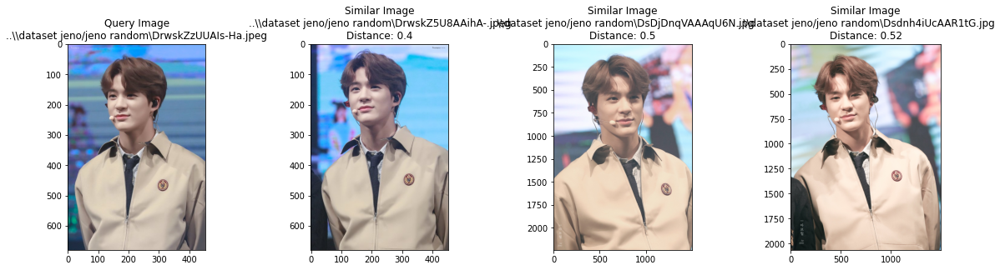

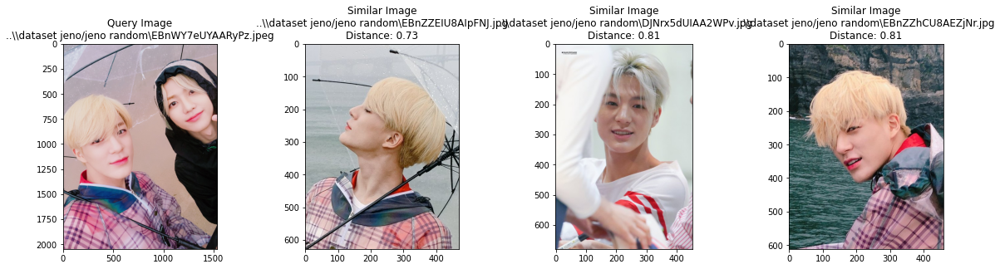

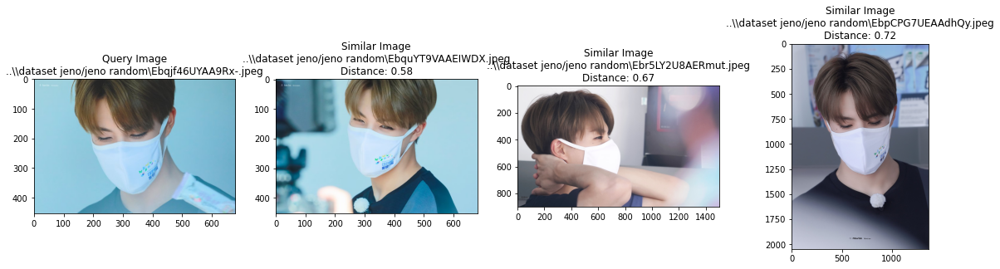

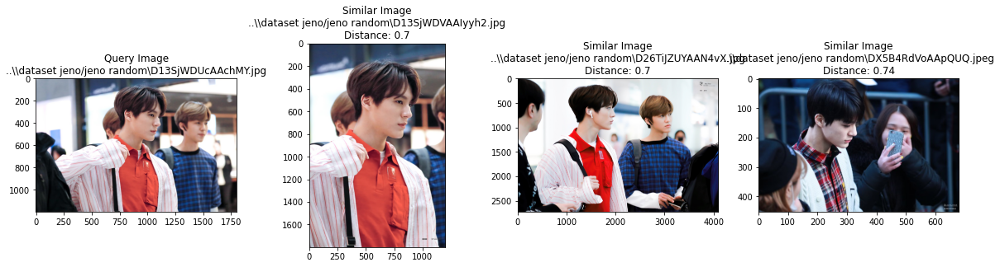

...

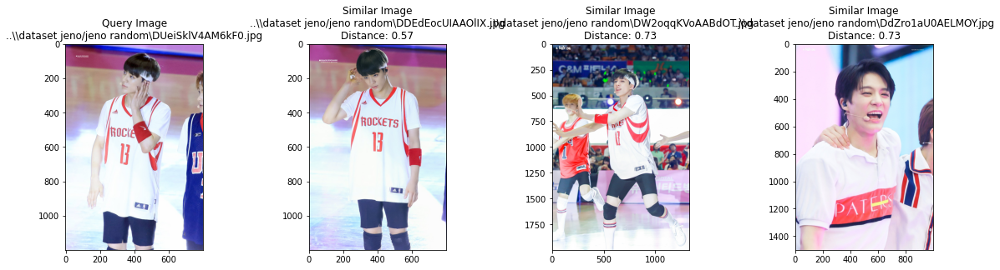

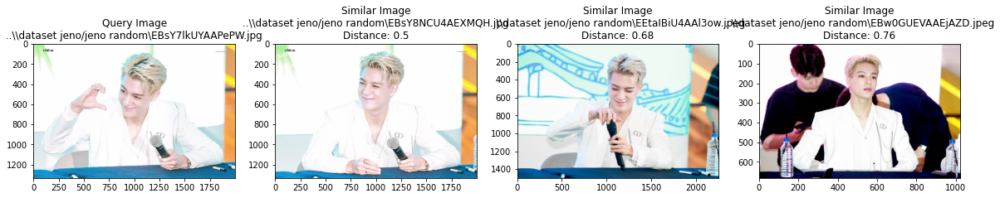

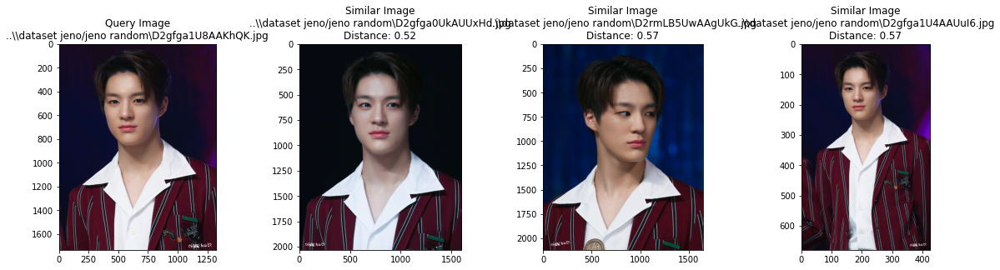

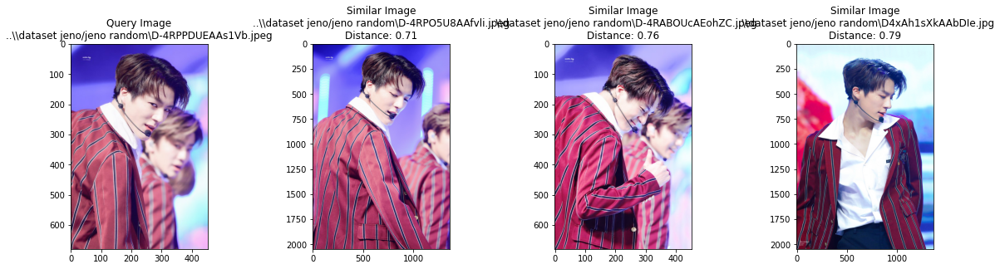

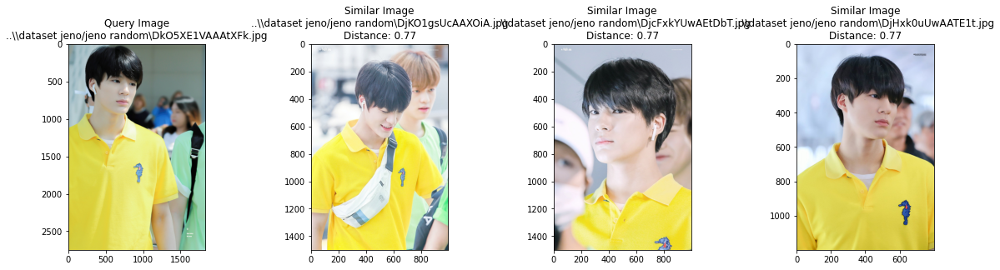

In [17]:
for i in range(40):
    random_image_index = random.randint(0, len(features_vgg19))
    distances, indices = neigbors_vgg19.kneighbors(
        [features_vgg19[random_image_index]]
    )

    # skip the 1st closest image cause it's very similar to query image
    similar_image_paths = [filenames[random_image_index]] + \
        [filenames[indices[0][i]] for i in range(1, 4)]
    plot_img(similar_image_paths, distances[0])

In [18]:
# plotting dengan menggunakan TSNE

# pilih sampel
selected_features = features_vgg19[:]
selected_classID = class_ids[:]
selected_filenames = filenames[:]

# plotting
jumlah_komponen = 2
verbose = 1
perplexity = 60
jumlah_iterasi = 1000
metric = 'euclidean'

time_start = time.time()
tsne_results = TSNE(n_components=jumlah_komponen,
                    verbose=verbose,
                    perplexity=perplexity,
                    n_iter=jumlah_iterasi,
                    metric=metric).fit_transform(selected_features)

print('t-SNE Selesai! total waktu yang dibutuhkan: {} sec'.format(time.time() - time_start))

c:\Users\zakis\anaconda3\envs\tf1\lib\site-packages\sklearn\manifold\_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
c:\Users\zakis\anaconda3\envs\tf1\lib\site-packages\sklearn\manifold\_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 181 nearest neighbors...
[t-SNE] Indexed 5481 samples in 0.002s...
[t-SNE] Computed neighbors for 5481 samples in 0.836s...
[t-SNE] Computed conditional probabilities for sample 1000 / 5481
[t-SNE] Computed conditional probabilities for sample 2000 / 5481
[t-SNE] Computed conditional probabilities for sample 3000 / 5481
[t-SNE] Computed conditional probabilities for sample 4000 / 5481
[t-SNE] Computed conditional probabilities for sample 5000 / 5481
[t-SNE] Computed conditional probabilities for sample 5481 / 5481
[t-SNE] Mean sigma: 0.229829
[t-SNE] KL divergence after 250 iterations with early exaggeration: 81.038063
[t-SNE] KL divergence after 1000 iterations: 2.286800
t-SNE Selesai! total waktu yang dibutuhkan: 18.40333843231201 sec


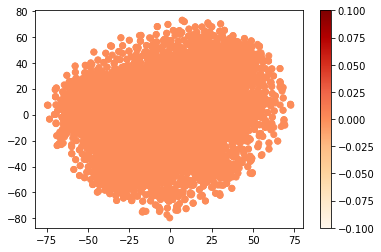

In [20]:
# plotting scatter plot
color_map = plt.cm.get_cmap('OrRd')
scatter_plot = plt.scatter(tsne_results[:, 0],
                            tsne_results[:, 1],
                            c = selected_classID,
                            cmap = color_map)

plt.colorbar(scatter_plot)
plt.show()

In [21]:
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from matplotlib.cbook import get_sample_data

def plot_images_in_2d(x, y, image_paths, axis=None, zoom=1):
    if axis is None:
        axis = plt.gca()
    x, y = np.atleast_1d(x, y)

    for x0, y0, image_paths in zip(x, y, image_paths):
        image = Image.open(image_paths)
        image.thumbnail((100, 100), Image.ANTIALIAS)
        img = OffsetImage(image, zoom=zoom)
        anno_box = AnnotationBbox(img, (x0, y0),
                                xycoords='data',
                                frameon=False)
        axis.add_artist(anno_box)
    axis.update_datalim(np.column_stack([x,y]))
    axis.autoscale()

In [22]:
def show_tsne(x, y, selected_filenames):
    fig, axis = plt.subplots()
    fig.set_size_inches(22, 22, forward=True)
    plot_images_in_2d(x, y, selected_filenames, zoom=0.3, axis=axis)
    plt.show()

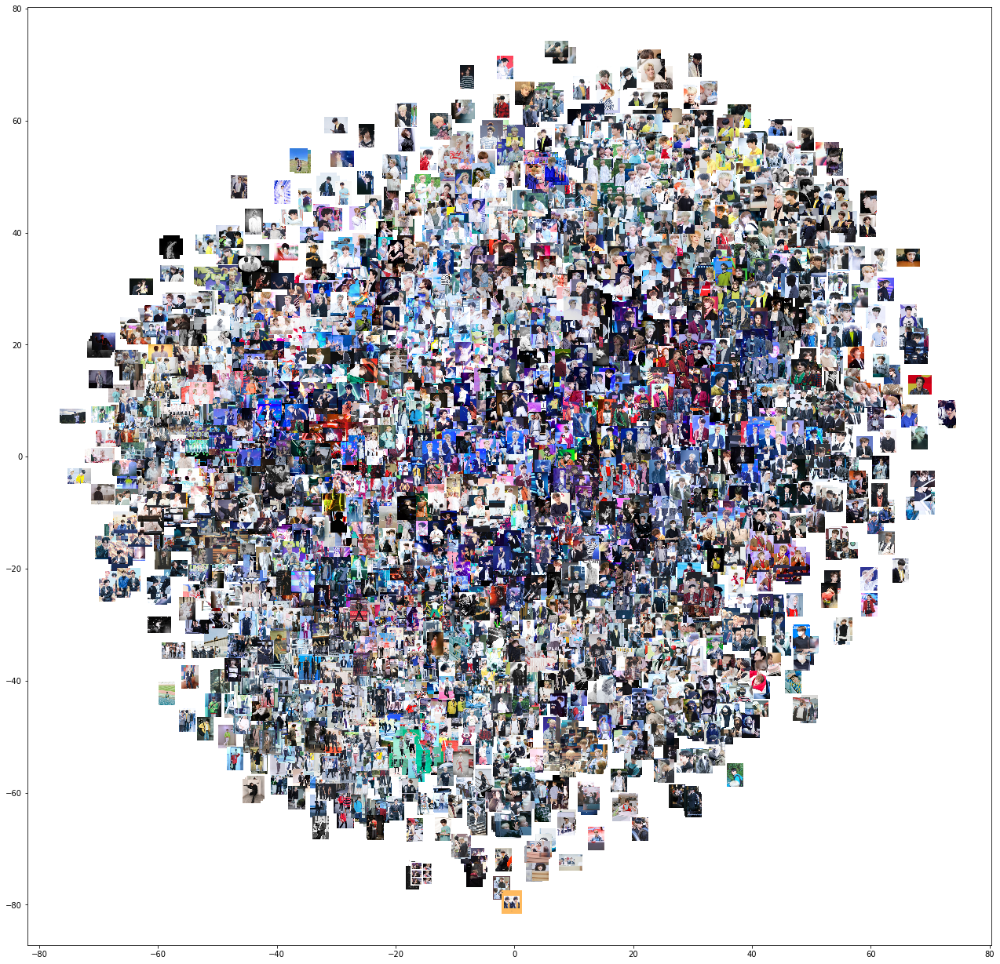

In [23]:
show_tsne(tsne_results[:, 0],
        tsne_results[:, 1],
        selected_filenames)